In [1]:
import os
import requests
import datetime
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopy
import folium
import plotly.express as px
from folium.plugins import HeatMap
from geopy.geocoders import Nominatim
from geopy.distance import geodesic

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score

In [2]:
path = os.getcwd()

In [3]:
df_raw = pd.read_csv(path + '\\sub_data\\' + 'uber.csv')


In [4]:
#Clean data: Remove any observations with missing attributes

#df_reduced = df_raw
df_cleaned = df_raw.loc[
    (df_raw.pickup_latitude != 0) & 
    (df_raw.pickup_longitude != 0) &
    (df_raw.dropoff_latitude != 0) &
    (df_raw.dropoff_longitude != 0) &
    (df_raw.fare_amount > 0) & 
    (df_raw.passenger_count > 0) 
]

In [5]:
#New York GPS Coordinates are roughly Latitude: 40, Longitude: -73
#The raw data includes some observations which mix up latitude and longitude, have comma errors etc.
# We will drop these observations (as opposed to imputing), as we cannot guarantee that the other fields are correct.

df_cleaned = df_cleaned.loc[
    ((-80 < df_raw.pickup_longitude)  & (df_raw.pickup_longitude < -70)) &
    ((35 < df_raw.pickup_latitude) & (df_raw.pickup_latitude < 45)) & 
    ((-80 < df_raw.dropoff_longitude)  & (df_raw.dropoff_longitude < -70)) &
    ((35 < df_raw.dropoff_latitude) & (df_raw.dropoff_latitude < 45))


]

In [6]:
geolocator = Nominatim(user_agent="Test")

In [7]:
testreversed = geolocator.reverse((40,40))

In [8]:
#df_reduced['pickup_coords'] = str(df_reduced['pickup_longitude']) + "," + str(df_reduced['pickup_latitude'])
#df_reduced['pickup_address'] = df_reduced.apply(geolocator.reverse((df_reduced.pickup_latitude, df_reduced.pickup_longitude)))

In [9]:
#pu_addresses = [geolocator.reverse([df_reduced.pickup_latitude.iloc[i], df_reduced.pickup_longitude.iloc[i]]) for i in range(len(df_reduced))]
#pu_addresses

In [10]:
# for i in range(len(df_reduced)):
#     df_reduced['country_code'].iloc[i] = pu_addresses[i].raw.get('address').get('country_code')
#     df_reduced['state'].iloc[i] = pu_addresses[i].raw.get('address').get('state')
#     df_reduced['city'].iloc[i] = pu_addresses[i].raw.get('address').get('city')
#     df_reduced['postcode'].iloc[i] = pu_addresses[i].raw.get('address').get('postcode')



In [11]:
map = folium.Map(
    location=[40.754932,-73.984016])

In [12]:
as_nparray = df_cleaned[['pickup_latitude', 'pickup_longitude']].to_numpy()
type(as_nparray)
as_nparray

HeatMap(
 zoom = 20,
 radius = 15,
 data = as_nparray
 ).add_to(map)

map

In [13]:
# test_zip = zip (
#     df_cleaned[['pickup_latitude', 'pickup_longitude']].to_numpy(),
#     df_cleaned[['dropoff_latitude', 'dropoff_longitude']].to_numpy()
# )

# print(list(test_zip)[:10])

# geodesic(test_zip)

In [14]:
## Distance 
###Geodesic


In [15]:
#Distance calculation
###TODO: Still uses "apply", which leads to bad performance. Still needs to be done differently (eg. operation on column level)
###TODO: Still geodesic (Air-Line) distance --> To be scaled by factor, eg. ~130% for street distance

list_distance = []
df_cleaned.apply(
    lambda row: list_distance.append(
        geodesic((row.pickup_latitude, row.pickup_longitude), (row.dropoff_latitude, row.dropoff_longitude)).km
    ),
    axis = 1    
)

0         None
1         None
2         None
3         None
4         None
          ... 
199995    None
199996    None
199997    None
199998    None
199999    None
Length: 195147, dtype: object

In [16]:
df_distance = pd.DataFrame(
    data = list_distance,
    columns= ['Distance'] 
    )

In [17]:
df_cleaned['distance_km'] = df_distance

In [18]:
df_cleaned.iloc[3:]

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance_km
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3,1.661442
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5,4.483730
5,44470845,2011-02-12 02:27:09.0000006,4.9,2011-02-12 02:27:09 UTC,-73.969019,40.755910,-73.969019,40.755910,1,0.000000
6,48725865,2014-10-12 07:04:00.0000002,24.5,2014-10-12 07:04:00 UTC,-73.961447,40.693965,-73.871195,40.774297,5,11.734667
8,15822268,2012-02-17 09:32:00.00000043,9.7,2012-02-17 09:32:00 UTC,-73.975187,40.745767,-74.002720,40.743537,1,4.891121
...,...,...,...,...,...,...,...,...,...,...
199995,42598914,2012-10-28 10:49:00.00000053,3.0,2012-10-28 10:49:00 UTC,-73.987042,40.739367,-73.986525,40.740297,1,NaN
199996,16382965,2014-03-14 01:09:00.0000008,7.5,2014-03-14 01:09:00 UTC,-73.984722,40.736837,-74.006672,40.739620,1,NaN
199997,27804658,2009-06-29 00:42:00.00000078,30.9,2009-06-29 00:42:00 UTC,-73.986017,40.756487,-73.858957,40.692588,2,NaN
199998,20259894,2015-05-20 14:56:25.0000004,14.5,2015-05-20 14:56:25 UTC,-73.997124,40.725452,-73.983215,40.695415,1,NaN


In [19]:
pd.value_counts(df_cleaned.distance_km == 0)

False    193153
True       1994
Name: distance_km, dtype: int64

In [20]:
#There are some trips for which distance was not calclated correctly - we will drop them
df_cleaned = df_cleaned.loc[df_cleaned.distance_km != 0]

In [21]:
pd.value_counts(df_cleaned.distance_km == 0)

False    193153
Name: distance_km, dtype: int64

In [22]:
##Time Analysis

#df_cleaned.pickup_date = 




In [23]:
strng = "2015-05-07 19:52:06 UTC"
test = datetime.datetime.strptime(strng, "%Y-%m-%d %H:%M:%S UTC")
test.hour

19

In [24]:
df_cleaned.pickup_datetime[0:][5:7]

6    2014-10-12 07:04:00 UTC
8    2012-02-17 09:32:00 UTC
Name: pickup_datetime, dtype: object

In [25]:
# df_cleaned.as_datetime = pd.to_datetime(
#     df_cleaned.pickup_datetime, 
#     format = "%Y-%m-%d %H:%M:%S UTC")

In [26]:
#df_cleaned.pickup_date = df_cleaned.as_datetime.dt.strftime('%d %b %Y')

df_cleaned["pickup_datetimeformatted"] = pd.to_datetime(
    arg = df_cleaned.pickup_datetime,
    format = "%Y-%m-%d %H:%M:%S UTC"
    )


# #First attempt to split datetime via string: Likely redundant (cannot be scaled) --> Commented out
# df_cleaned['pickup_year'] = df_cleaned.pickup_datetimeformatted.dt.strftime('%Y')
# df_cleaned['pickup_month'] = df_cleaned.pickup_datetimeformatted.dt.strftime('%m')
# df_cleaned['pickup_day'] = df_cleaned.pickup_datetimeformatted.dt.strftime('%d')
# df_cleaned['pickup_weekday'] = df_cleaned.pickup_datetimeformatted.dt.strftime('%A')
# df_cleaned['pickup_time'] = df_cleaned.pickup_datetimeformatted.dt.strftime('%H:%M:%S')
# df_cleaned['pickup_hour'] = df_cleaned.pickup_datetimeformatted.dt.strftime('%H')



In [27]:
##Splitting up the datetime into integer so that it can be scaled and then used in the clustering

#df_cleaned["no_year"], df_cleaned["no_month"], df_cleaned["no_day"]  = df_cleaned.pickup_datetimeformatted.dt.isocalendar()

df_cleaned["no_year"] = df_cleaned.pickup_datetimeformatted.dt.year
df_cleaned["no_month"] = df_cleaned.pickup_datetimeformatted.dt.month
df_cleaned["no_day"] = df_cleaned.pickup_datetimeformatted.dt.day



df_cleaned['no_hour'] = df_cleaned.pickup_datetimeformatted.dt.hour

df_cleaned['no_weekday'] = df_cleaned.pickup_datetimeformatted.dt.dayofweek

df_cleaned.head()




,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance_km,pickup_datetimeformatted,no_year,no_month,no_day,no_hour,no_weekday
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1,1.681111,2015-05-07 19:52:06,2015,5,7,19,3
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1,2.454363,2009-07-17 20:04:56,2009,7,17,20,4
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1,5.039603,2009-08-24 21:45:00,2009,8,24,21,0
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3,1.661442,2009-06-26 08:22:21,2009,6,26,8,4
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5,4.483730,2014-08-28 17:47:00,2014,8,28,17,3


In [28]:
df_cleaned.dtypes

Unnamed: 0                           int64
key                                 object
fare_amount                        float64
pickup_datetime                     object
pickup_longitude                   float64
pickup_latitude                    float64
dropoff_longitude                  float64
dropoff_latitude                   float64
passenger_count                      int64
distance_km                        float64
pickup_datetimeformatted    datetime64[ns]
no_year                              int64
no_month                             int64
no_day                               int64
no_hour                              int64
no_weekday                           int64
dtype: object

In [29]:
px.histogram(
    data_frame = df_cleaned.distance_km
)

In [30]:
px.histogram(
    data_frame = df_cleaned.no_year
)

In [31]:
# px.histogram(
#     data_frame = df_cleaned.pickup_weekday,
#     x = "pickup_weekday",
#     category_orders=dict(pickup_weekday=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"])
# )

px.histogram(
    data_frame = df_cleaned.no_weekday,
    )

In [32]:
px.histogram(
    data_frame = df_cleaned.no_hour
    
    ).update_xaxes(categoryorder = "category ascending")

In [33]:
df_cleaned.head()

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance_km,pickup_datetimeformatted,no_year,no_month,no_day,no_hour,no_weekday
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1,1.681111,2015-05-07 19:52:06,2015,5,7,19,3
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1,2.454363,2009-07-17 20:04:56,2009,7,17,20,4
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1,5.039603,2009-08-24 21:45:00,2009,8,24,21,0
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3,1.661442,2009-06-26 08:22:21,2009,6,26,8,4
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5,4.483730,2014-08-28 17:47:00,2014,8,28,17,3


In [34]:
df_cleaned.dtypes

Unnamed: 0                           int64
key                                 object
fare_amount                        float64
pickup_datetime                     object
pickup_longitude                   float64
pickup_latitude                    float64
dropoff_longitude                  float64
dropoff_latitude                   float64
passenger_count                      int64
distance_km                        float64
pickup_datetimeformatted    datetime64[ns]
no_year                              int64
no_month                             int64
no_day                               int64
no_hour                              int64
no_weekday                           int64
dtype: object

In [78]:
###Drop all columns with Missing Values
# df_scaled = df_scaled.dropna(
#     axis = 1,
#     how = 'any'
# )

###Drop all rows with Missing Values

df_cleaned = df_cleaned.dropna(
    axis = 0,
    how = 'any'
)

In [99]:
# Comparison of Clustering methods
#Clustering is relevant for the purpose of customer segmentation (can we meaningfully differentiate the trips into types )
##Prep for scaling: Drop all string columns, drop all NaN columns


df_scaled = df_cleaned.drop(columns = ['key', 'pickup_datetime', 'pickup_datetimeformatted'])

#The distance column still contains value with distance = 0, for unknown reason. As na values block the clustering, drop this for the time being.
# df_scaled = df_scaled.drop(
#     labels = ['distance_km'],
#     axis = 1,
#     inplace = True)




In [100]:
#Check: Removed columns
df_scaled.dtypes

Unnamed: 0             int64
fare_amount          float64
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
passenger_count        int64
distance_km          float64
no_year                int64
no_month               int64
no_day                 int64
no_hour                int64
no_weekday             int64
cls_label              int32
dtype: object

In [101]:
#Check: Remaining Rows
len(df_scaled)

188415

In [102]:
#Save labels for later

scaledlabels = df_scaled.columns.tolist()
#len(scaledlabels)
scaledlabels

['Unnamed: 0',
 'fare_amount',
 'pickup_longitude',
 'pickup_latitude',
 'dropoff_longitude',
 'dropoff_latitude',
 'passenger_count',
 'distance_km',
 'no_year',
 'no_month',
 'no_day',
 'no_hour',
 'no_weekday',
 'cls_label']

In [83]:
##create a df with scaled data for clustering
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_scaled)

In [84]:
cls_kmeans = KMeans(
    init = "random",
    n_clusters = 3,
    n_init = 10,
    max_iter = 300,
    random_state = 42
)

In [85]:
cls_kmeans.fit(df_scaled)

KMeans(init='random', n_clusters=3, random_state=42)

In [86]:
###Add the labels to the observations
df_withLabels = df_cleaned 

df_withLabels['cls_label'] = cls_kmeans.labels_

In [87]:
##Evaluating the results of the clustering

### Whwere are the centroids
cls_kmeans.cluster_centers_

array([[ 3.26995005e-03, -2.03522365e-01, -1.47115431e-01,
         3.42444322e-02, -1.23680031e-01,  2.59756592e-02,
         7.86651998e-03,  6.20653534e-05, -3.02445852e-01,
         8.66452813e-01, -1.01299685e-02, -6.92305669e-03,
        -8.41639842e-03, -1.06724993e+00],
       [ 6.43542274e-03,  2.68787044e+00,  1.97606959e+00,
        -4.99951878e-01,  1.63448570e+00, -3.95076379e-01,
         1.69178740e-02,  9.69031426e-03,  1.14935965e-01,
         4.85416210e-02, -6.33375982e-03, -4.01228444e-02,
        -3.51153896e-02, -3.03131275e-02],
       [-3.99739754e-03, -1.95871089e-01, -1.46357937e-01,
         3.98240216e-02, -1.19184943e-01,  3.24892784e-02,
        -9.82332132e-03, -1.45349826e-03,  2.67479762e-01,
        -8.20678744e-01,  1.04250341e-02,  1.22783647e-02,
         1.29597947e-02,  1.00662368e+00]])

In [88]:
##Evaluation
### How many Iterations were needed for converging?

cls_kmeans.n_iter_

10

In [89]:
### k-means works by allocating the observations to a centroid. Performance is measured with the SSE of the clusters, called "inertia". 
### How big is the inertia value? ()

cls_kmeans.inertia_

2111382.034005385

In [90]:
## We have started with n1 = 3 clusters. What is the ideal number of clusters?
## To do this we make an elbow plot, which plots the number of clusters vs. their inertia

kmeans_settings = {
    "init" : "random",
    "n_init" : 10,
    "max_iter" : 300,
    "random_state" : 42
}

runs_inertia = []

for k in range (1,10):
    cls_kmeans_elbow = KMeans(
        n_clusters = k,
        **kmeans_settings
    )
    cls_kmeans_elbow.fit(df_scaled)
    runs_inertia.append (cls_kmeans_elbow.inertia_)

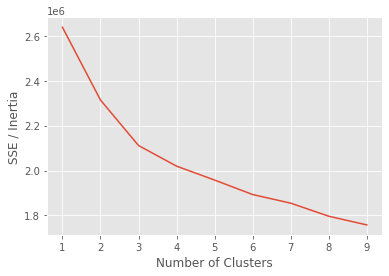

In [91]:
plt.style.use("ggplot")
plt.plot(range(1, 10), runs_inertia)
plt.xticks(range(1, 10))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE / Inertia")
plt.show()

In [92]:
## 4 Should be a good number

In [93]:
# ##Silhouette Coefficient


# kmeans_settings = {
#     "init" : "random",
#     "n_init" : 10,
#     "max_iter" : 300,
#     "random_state" : 42
# }

# runs_silhouette = []

# for k in range (2,10):
#     cls_kmeans_silhouette = KMeans(
#         n_clusters = k,
#         **kmeans_settings
#     )
#     cls_kmeans_silhouette.fit(df_scaled)
    
#     silhouette_k = silhouette_score(df_scaled, cls_kmeans_silhouette.labels_)
#     runs_silhouette.append (silhouette_k)

In [94]:
# plt.style.use("ggplot")
# plt.plot(range(2, 10), runs_silhouette)
# plt.xticks(range(2, 10))
# plt.xlabel("k: Number of Clusters")
# plt.ylabel("Silhouette coefficient for k")
# plt.show()

In [95]:
#Commented out: takes very long

#Maximum at n = 2 clusters

In [96]:
len(scaledlabels)

14

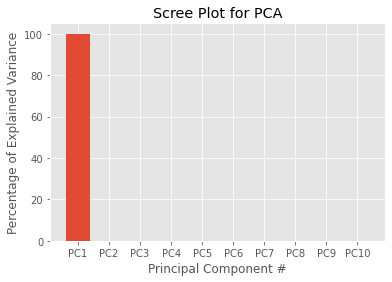

In [104]:
from sklearn.decomposition import PCA

n_PCA_Components = 10

pca = PCA(n_components = n_PCA_Components)
pca.fit(df_scaled)
data_pca_transformed = pca.transform(df_scaled)


labels_pca = ['PC'+str(x) for x in range(1, n_PCA_Components+1)]
df_pca = pd.DataFrame(data_pca_transformed, columns = labels_pca)


expVarPerComponent = np.round(pca.explained_variance_ratio_ * 100, decimals = 1 )




plt.bar(x = range (1, len(expVarPerComponent) + 1), height = expVarPerComponent, tick_label = labels_pca)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel ('Principal Component #')
plt.title('Scree Plot for PCA')
plt.show()

Interpretation: Dimension Reduction is challenging here - Principal Components are similar in their explained variance

In [108]:
#What are the loading scores for the different attributes?

pd.Series(pca.components_[0], index = scaledlabels)

Unnamed: 0          -1.000000e+00
fare_amount         -4.319317e-10
pickup_longitude    -5.315973e-13
pickup_latitude     -1.948351e-12
dropoff_longitude   -9.400122e-12
dropoff_latitude     5.096717e-13
passenger_count     -1.584041e-10
distance_km          5.495865e-11
no_year              1.826049e-10
no_month            -6.147402e-10
no_day              -6.313316e-10
no_hour              1.136860e-10
no_weekday           5.791512e-10
cls_label            2.119795e-10
dtype: float64

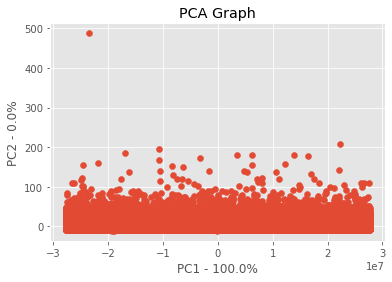

In [106]:
plt.scatter(df_pca.PC1, df_pca.PC2)
plt.title('PCA Graph')
plt.xlabel('PC1 - {0}%'.format(expVarPerComponent[0]))
plt.ylabel('PC2 - {0}%'.format(expVarPerComponent[1]))

for sample in df_pca.index:
     #plt.annotate(sample, (df_pca.PC1.loc[sample], df_pca.PC2.loc[sample]))
     #plt.annotate(sample, (df_data_raw.WineClass.loc[sample]))
    colors = ["y", "r","g","b"]
    
    # plt.annotate(
    #      xy = (df_pca.PC1.loc[sample], df_pca.PC2.loc[sample]),
    #      text = df_data_raw.WineClass[sample], 
    #      color = colors[df_data_raw.WineClass[sample]]        
    #      )
     
plt.show()